In [9]:
!pip install plotly==4.12.0

In [79]:
import pandas as pd
import numpy as np
import pickle
import time
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from urllib.request import urlopen
import json
from tqdm import tqdm

In [3]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

In [74]:
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=fips_df.fips, z=fips_df.number,
                                    colorscale="Tealgrn", zmin=0, zmax=30,
                                    marker_opacity=1, marker_line_width=0))
fig.update_layout(mapbox_style="carto-darkmatter",
                  mapbox_zoom=3.5, mapbox_center = {"lat": 62.1198, "lon": -155.4393})
fig.update_layout(autosize=False, width=1400, height=900, margin={"r":5,"t":0,"l":1,"b":0})
fig.show()
plt.savefig("Alaska.png");

<Figure size 432x288 with 0 Axes>

In [73]:
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=fips_df.fips, z=fips_df.number,
                                    colorscale="Purp", zmin=0, zmax=30,
                                    marker_opacity=1, marker_line_width=0))
fig.update_layout(mapbox_style="carto-darkmatter",
                  mapbox_zoom=3.5, mapbox_center = {"lat": 62.1198, "lon": -155.4393})
fig.update_layout(autosize=False, width=1400, height=900, margin={"r":5,"t":0,"l":1,"b":0})
fig.show()
plt.savefig("Alaska 2.png");

<Figure size 432x288 with 0 Axes>

## Population density map

In [14]:
population_density = [0, 1, 175, 0, 2, 0, 0, 14, 1, 12, 4, 3, 2, 0, 4, 0, 0, 0, 1, 3, 2, 0, 0, 0, 1, 0, 0]

In [16]:
fips_dict = {"fips": ["02013", "02016", "02020", "02050", "02060", "02068", "02070", "02090", "02100", "02110", "02122", "02130", "02150", "02164", "02170", "02180", "02185", "02188", "02201", "02220", "02232", "02240", "02261", "02270", "02280", "02282", "02290"], "names": ["Aleutians East", "Aleutians West", "Anchorage", "Bethel", "Bristol Bay", "Denali", "Dillingham", "Fairbanks North Star", "Haines", "Juneau", "Kenai Peninsula", "Ketchikan Gateway", "Kodiak Island", "Lake and Peninsula", "Matanuska-Susitna", "Nome", "North Slope", "Northwest Arctic", "Prince of Wales-Outer Ketchikan", "Sitka", "Skagway-Hoonah-Angoon", "Southeast Fairbanks", "Valdez-Cordova", "Wade Hampton", "Wrangell-Petersburg", "Yakutat", "Yukon-Koyukuk"], "Population density": population_density}
fips_df = pd.DataFrame(fips_dict)

In [17]:
fips_df

,fips,names,Population density
0,02013,Aleutians East,0
1,02016,Aleutians West,1
2,02020,Anchorage,175
3,02050,Bethel,0
4,02060,Bristol Bay,2
5,02068,Denali,0
6,02070,Dillingham,0
7,02090,Fairbanks North Star,14
8,02100,Haines,1
9,02110,Juneau,12


In [20]:
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=fips_df["fips"], z=fips_df["Population density"],
                                    colorscale="Tealgrn", zmin=0, zmax=30,
                                    marker_opacity=1, marker_line_width=1))
fig.update_layout(mapbox_style="carto-darkmatter",
                  mapbox_zoom=3.5, mapbox_center = {"lat": 62.1198, "lon": -155.4393})
fig.update_layout(autosize=False, width=1400, height=900, margin={"r":5,"t":0,"l":1,"b":0})
fig.show();

In [23]:
with open("newest_main_df.pickle", "rb") as to_read:
    main_df = pickle.load(to_read)

In [6]:
!pip install wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt

  Using cached wordcloud-1.8.0-cp38-cp38-macosx_10_6_x86_64.whl (162 kB)


In [79]:
text = " ".join(list(main_df["Cleaned review v2"].values))

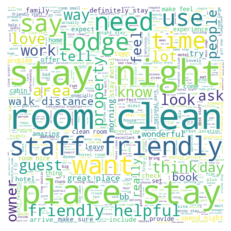

In [81]:
wc = WordCloud(background_color="white", max_words=2000, max_font_size=256,
               random_state=10, width=1000, height=1000)
wc.generate(text)
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show()

In [70]:
from PIL import Image
import numpy as np

In [7]:
def one_color_func(word=None, font_size=None, 
                   position=None, orientation=None, 
                   font_path=None, random_state=None):
    h = 160 # 0 - 360
    s = 100 # 0 - 100
    l = 50 # 0 - 100
    return "hsl({}, {}%, {}%)".format(h, s, l)

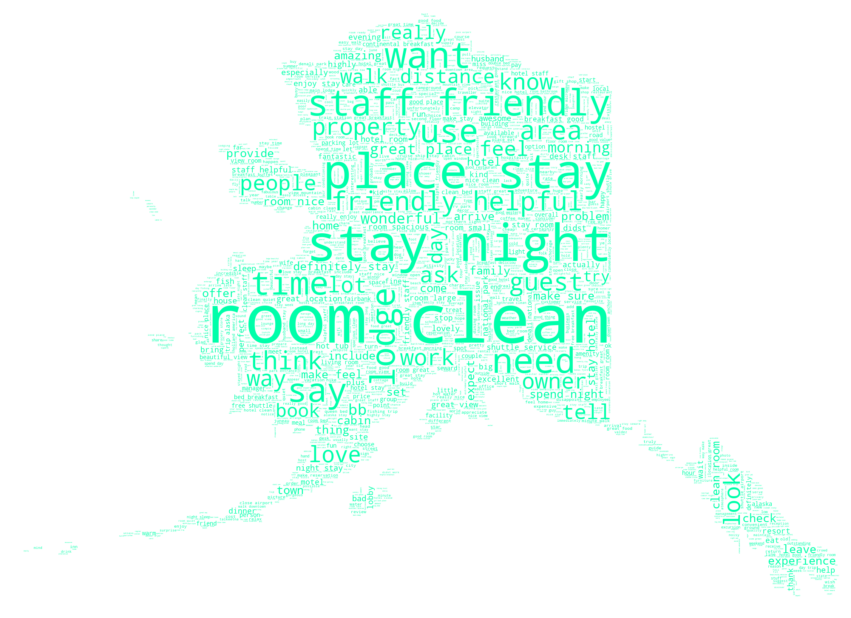

In [93]:
plt.figure(figsize=(15, 15))
AK_shape = np.array(Image.open('Alaska shape.png'))
wc = WordCloud(mask=AK_shape, background_color="white",
               max_words=2000, max_font_size=256,
               random_state=10, width=AK_shape.shape[1],
               height=AK_shape.shape[0], color_func=one_color_func)
wc.generate(text)
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show()

# Mapping "Review nouns"

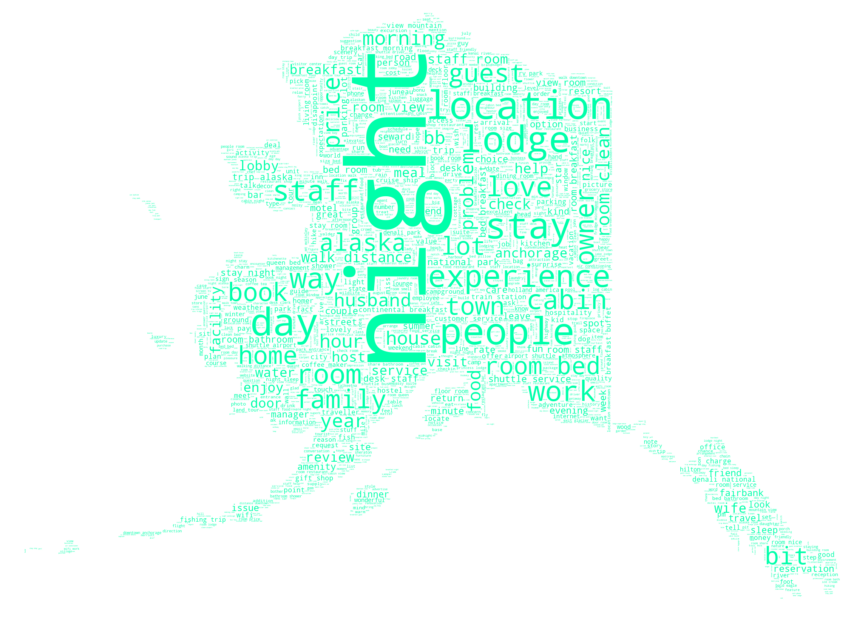

In [11]:
text = " ".join(list(main_df["Review nouns"].values))
custom_stops = ["didst", "area", "hotel", "property", "thing", "place", "time", "use"]
plt.figure(figsize=(15, 15))
AK_shape = np.array(Image.open('Alaska shape.png'))
wc = WordCloud(stopwords=custom_stops, mask=AK_shape, background_color="white",
               max_words=2000, max_font_size=256,
               random_state=10, width=AK_shape.shape[1],
               height=AK_shape.shape[0], color_func=one_color_func)
wc.generate(text)
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show();

# Making a "night" feature

In [12]:
def get_night_reviews(review):

    if "night" in review:
        return 1
    else:
        return 0

In [21]:
def get_reviews_with(review, list_of_words):

    value = 0
    for word in list_of_words:
        if word in review:
            value = 1
            break
    return value

In [26]:
night_list = []
for i in range(main_df.shape[0]):
    print(i)
    night_list.append(get_night_reviews(main_df.iloc[i]["Review nouns"]))
main_df["WORD: 'night'"] = night_list

9
91180
91181
91182
91183
91184
91185
91186
91187
91188
91189
91190
91191
91192
91193
91194
91195
91196
91197
91198
91199
91200
91201
91202
91203
91204
91205
91206
91207
91208
91209
91210
91211
91212
91213
91214
91215
91216
91217
91218
91219
91220
91221
91222
91223
91224
91225
91226
91227
91228
91229
91230
91231
91232
91233
91234
91235
91236
91237
91238
91239
91240
91241
91242
91243
91244
91245
91246
91247
91248
91249
91250
91251
91252
91253
91254
91255
91256
91257
91258
91259
91260
91261
91262
91263
91264
91265
91266
91267
91268
91269
91270
91271
91272
91273
91274
91275
91276
91277
91278
91279
91280
91281
91282
91283
91284
91285
91286
91287
91288
91289
91290
91291
91292
91293
91294
91295
91296
91297
91298
91299
91300
91301
91302
91303
91304
91305
91306
91307
91308
91309
91310
91311
91312
91313
91314
91315
91316
91317
91318
91319
91320
91321
91322
91323
91324
91325
91326
91327
91328
91329
91330
91331
91332
91333
91334
91335
91336
91337
91338
91339
91340
91341
91342
91343
91344
91345
91

In [30]:
night_mask = main_df["WORD: 'night'"] == 1
reviews_with_night = main_df[night_mask]

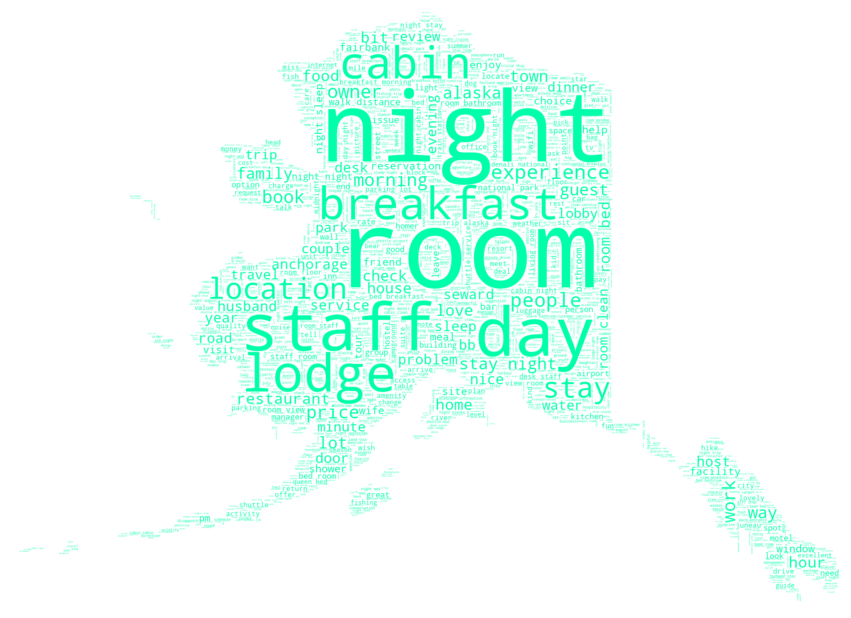

In [32]:
text = " ".join(list(reviews_with_night["Review nouns"].values))
custom_stops = ["didst", "area", "hotel", "property", "thing", "place", "time", "use"]
plt.figure(figsize=(15, 15))
AK_shape = np.array(Image.open('Alaska shape.png'))
wc = WordCloud(stopwords=custom_stops, mask=AK_shape, background_color="white",
               max_words=2000, max_font_size=256,
               random_state=10, width=AK_shape.shape[1],
               height=AK_shape.shape[0], color_func=one_color_func)
wc.generate(text)
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show();

In [34]:
wish_list = []
for i in range(main_df.shape[0]):
    print(i)
    wish_list.append(get_reviews_with(main_df.iloc[i]["Cleaned review v2"], ["wish"]))
main_df["WORD: 'wish'"] = wish_list

9
91180
91181
91182
91183
91184
91185
91186
91187
91188
91189
91190
91191
91192
91193
91194
91195
91196
91197
91198
91199
91200
91201
91202
91203
91204
91205
91206
91207
91208
91209
91210
91211
91212
91213
91214
91215
91216
91217
91218
91219
91220
91221
91222
91223
91224
91225
91226
91227
91228
91229
91230
91231
91232
91233
91234
91235
91236
91237
91238
91239
91240
91241
91242
91243
91244
91245
91246
91247
91248
91249
91250
91251
91252
91253
91254
91255
91256
91257
91258
91259
91260
91261
91262
91263
91264
91265
91266
91267
91268
91269
91270
91271
91272
91273
91274
91275
91276
91277
91278
91279
91280
91281
91282
91283
91284
91285
91286
91287
91288
91289
91290
91291
91292
91293
91294
91295
91296
91297
91298
91299
91300
91301
91302
91303
91304
91305
91306
91307
91308
91309
91310
91311
91312
91313
91314
91315
91316
91317
91318
91319
91320
91321
91322
91323
91324
91325
91326
91327
91328
91329
91330
91331
91332
91333
91334
91335
91336
91337
91338
91339
91340
91341
91342
91343
91344
91345
91

In [44]:
with open("newest_main_df.pickle", "wb") as to_write:
     pickle.dump(main_df, to_write)

In [37]:
main_df["WORD: 'wish'"].value_counts()

0    92012
1     2501
Name: WORD: 'wish', dtype: int64

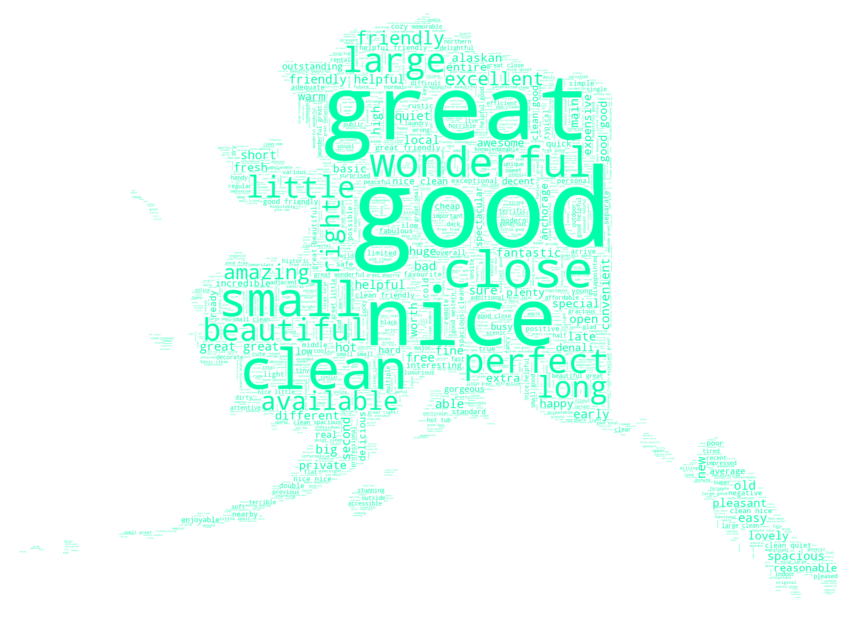

In [38]:
text = " ".join(list(main_df["Review adjs"].values))
plt.figure(figsize=(15, 15))
AK_shape = np.array(Image.open('Alaska shape.png'))
wc = WordCloud(stopwords=custom_stops, mask=AK_shape, background_color="white",
               max_words=2000, max_font_size=256,
               random_state=10, width=AK_shape.shape[1],
               height=AK_shape.shape[0], color_func=one_color_func)
wc.generate(text)
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show();

In [39]:
main_df

,Property name,Property address,"Lat, long",Reviewer,Review date,Date of stay,Review title,Full review,Review link,Spell-checked review,...,Year of stay,Vader +,Vader -,Cleaned review v2,Review length,Review nouns,Review adjs,WORD: 'night',"WORD: 'aurora', 'northern lights'",WORD: 'wish'
0,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",John M,October 2020,October 2020,Awesome hotel doing all the right things,I stay at lots of hotels (including during Cov...,https://www.tripadvisor.com/ShowUserReviews-g6...,I stay at lots of hotels including during ovid...,...,2020.0,0.250,0.000,stay lot hotel include ovid harbour right grea...,97,lot hotel harbour hotel price excellent locati...,right great fair friendly clean reasonable,1,0,0
1,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",Kenai Drift Anglers,October 2020,October 2020,Great Local Get Away,My girlfriend just wanted to get away from tow...,https://www.tripadvisor.com/ShowUserReviews-g6...,My girlfriend just wanted to get away from tow...,...,2020.0,0.480,0.049,girlfriend want away town enjoy great evening ...,52,girlfriend town evening restriction hotel brea...,great covid great,0,0,0
2,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",TravelGirl2006,October 2020,October 2020,We love this hotel,Have stayed here twice on our last two trips t...,https://www.tripadvisor.com/ShowUserReviews-g6...,Have stayed here twice on our last two trips t...,...,2020.0,0.480,0.000,stay twice trip seward view marina fantastic r...,100,trip seward view marina room spotless bathroom...,fantastic large good adapt covid friendly grea...,0,0,0
3,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",maduro44,October 2020,September 2020,Bed,Everything was really nice almost great if it ...,https://www.tripadvisor.com/ShowUserReviews-g6...,Everything was really nice almost great if it ...,...,2020.0,0.440,0.158,really nice great haunt bed bed horrible mattr...,54,haunt bed bed horrible mattress help year bed,nice great,0,0,0
4,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",rtfields2020,October 2020,September 2020,Great place,"Terrific place to stay. Comfortable and clean,...",https://www.tripadvisor.com/ShowUserReviews-g6...,Terrific place to stay. Comfortable and clean ...,...,2020.0,0.401,0.000,terrific place clean friendly staff excellent ...,45,place staff breakfast sit balcony mountain har...,terrific clean friendly excellent incredible r...,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111306,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",BigBubbaSpokane,August 2007,August 2007,Horror in Anchorage,"This is the most disgusting, filthy, unsanitar...",https://www.tripadvisor.com/ShowUserReviews-g6...,This is the most disgusting filthy unsanitary ...,...,2007.0,0.047,0.391,disgust filthy unsanitary rundown hole encount...,77,disgust filthy rundown hole encounter daughter...,unsanitary late gross terrible bad,1,0,0
111307,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",Angeles,July 2007,July 2007,Do not stay here,This hotel was booked for us as part of a grou...,https://www.tripadvisor.com/ShowUserReviews-g6...,This hotel was booked for us as part of a grou...,...,2007.0,0.000,0.138,hotel book group couple suppose stay night cou...,153,hotel book group couple stay night couple plac...,awful second denali old large denali,1,0,0
111308,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",754Lynn,July 2005,July 2005,Misleading-- Don't fall for this dump of a Hot...,I booked a hotel on the road using a well know...,https://www.tripadvisor.com/ShowUserReviews-g6...,I booked a hotel on the road using a well know...,...,2005.0,0.211,0.024,book hotel road use know hotel website book ho...,149,book hotel road use know 

In [42]:
main_df["Sentiment net"] = main_df["Vader +"] - main_df["Vader -"]

In [43]:
main_df

,Property name,Property address,"Lat, long",Reviewer,Review date,Date of stay,Review title,Full review,Review link,Spell-checked review,...,Vader +,Vader -,Cleaned review v2,Review length,Review nouns,Review adjs,WORD: 'night',"WORD: 'aurora', 'northern lights'",WORD: 'wish',Sentiment net
0,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",John M,October 2020,October 2020,Awesome hotel doing all the right things,I stay at lots of hotels (including during Cov...,https://www.tripadvisor.com/ShowUserReviews-g6...,I stay at lots of hotels including during ovid...,...,0.250,0.000,stay lot hotel include ovid harbour right grea...,97,lot hotel harbour hotel price excellent locati...,right great fair friendly clean reasonable,1,0,0,0.250
1,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",Kenai Drift Anglers,October 2020,October 2020,Great Local Get Away,My girlfriend just wanted to get away from tow...,https://www.tripadvisor.com/ShowUserReviews-g6...,My girlfriend just wanted to get away from tow...,...,0.480,0.049,girlfriend want away town enjoy great evening ...,52,girlfriend town evening restriction hotel brea...,great covid great,0,0,0,0.431
2,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",TravelGirl2006,October 2020,October 2020,We love this hotel,Have stayed here twice on our last two trips t...,https://www.tripadvisor.com/ShowUserReviews-g6...,Have stayed here twice on our last two trips t...,...,0.480,0.000,stay twice trip seward view marina fantastic r...,100,trip seward view marina room spotless bathroom...,fantastic large good adapt covid friendly grea...,0,0,0,0.480
3,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",maduro44,October 2020,September 2020,Bed,Everything was really nice almost great if it ...,https://www.tripadvisor.com/ShowUserReviews-g6...,Everything was really nice almost great if it ...,...,0.440,0.158,really nice great haunt bed bed horrible mattr...,54,haunt bed bed horrible mattress help year bed,nice great,0,0,0,0.282
4,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",rtfields2020,October 2020,September 2020,Great place,"Terrific place to stay. Comfortable and clean,...",https://www.tripadvisor.com/ShowUserReviews-g6...,Terrific place to stay. Comfortable and clean ...,...,0.401,0.000,terrific place clean friendly staff excellent ...,45,place staff breakfast sit balcony mountain har...,terrific clean friendly excellent incredible r...,0,0,0,0.401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111306,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",BigBubbaSpokane,August 2007,August 2007,Horror in Anchorage,"This is the most disgusting, filthy, unsanitar...",https://www.tripadvisor.com/ShowUserReviews-g6...,This is the most disgusting filthy unsanitary ...,...,0.047,0.391,disgust filthy unsanitary rundown hole encount...,77,disgust filthy rundown hole encounter daughter...,unsanitary late gross terrible bad,1,0,0,-0.344
111307,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",Angeles,July 2007,July 2007,Do not stay here,This hotel was booked for us as part of a grou...,https://www.tripadvisor.com/ShowUserReviews-g6...,This hotel was booked for us as part of a grou...,...,0.000,0.138,hotel book group couple suppose stay night cou...,153,hotel book group couple stay night couple plac...,awful second denali old large denali,1,0,0,-0.138
111308,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",754Lynn,July 2005,July 2005,Misleading-- Don't fall for this dump of a Hot...,I booked a hotel on the road using a well know...,https://www.tripadvisor.com/ShowUserReviews-g6...,I booked a hotel on the road using a well know...,...,0.211,0.024,book hotel road use know hotel website book ho...,149,book hotel road use know hotel websi

In [46]:
main_df.to_csv("Updated df.csv")

In [39]:
with open("corex_df.pickle", "rb") as to_read:
    corex_df = pickle.load(to_read)

In [49]:
corex_df.head()

,Topics,Anchors,Topic words,TC,TCs,Labels,Clusters,Alpha,Mis,P(y)|x,Words,N-gram range,min_df,max_df
0,3,"[[hotel, lodge], [aurora, northern lights]]","[Topic #3: dirty, smell, tell, stain, carpet, ...",0.505090,"[0.3092723551510655, 0.13949227728254487, 0.05...","[[True, False, False], [False, False, False], ...","[1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 2, 1, 0, 0, 0, ...","[[0.0, 1.0, 1.0, 1.0, 1.0, 9.951015475427494e-...","[[0.0, 3.274388527726461e-05, 8.22262491498496...","[[0.9986490474624738, 0.0012507153180690215, 0...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
1,4,"[[hotel, lodge], [aurora, northern lights]]","[Topic #4: fishing, fish, guide, catch, halibu...",0.514217,"[0.014229080675627644, 0.016651559869778544, 0...","[[False, False, True, False], [False, False, F...","[3, 2, 2, 2, 2, 2, 2, 2, 0, 2, 3, 3, 1, 2, 2, ...","[[2.932473488247884e-113, 0.05673424774783181,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.46...","[[0.001209846176259916, 0.0005339934082038572,...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
2,5,"[[hotel, lodge], [aurora, northern lights]]","[Topic #5: ride curtail, make cab, curtail, pl...",0.510543,"[0.014799703123339903, 0.13055279683625526, 0....","[[False, False, True, False, False], [False, F...","[1, 2, 2, 2, 2, 2, 2, 2, 1, 3, 3, 1, 2, 2, 2, ...","[[0.0, 0.0, 0.0, 0.0, 0.0, 8.666026195238217e-...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0007540549783578407, 0.0023923127259825178...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
3,6,"[[hotel, lodge], [aurora, northern lights]]","[Topic #6: desk, shuttle, airport]",0.503781,"[0.01510818998448211, 0.12954623085726427, 6.9...","[[False, False, False, False, True, True], [Fa...","[1, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 1, 2, 5, 5, ...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 8.86...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0015577804581940605, 0.0022115408769414254...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
4,7,"[[hotel, lodge], [aurora, northern lights]]","[Topic #7: fishing, fish, guide, catch, salmon...",0.519461,"[0.35442337349202446, -1.4957993464916237e-06,...","[[False, False, False, False, False, False, Fa...","[6, 0, 0, 0, 0, 0, 0, 0, 4, 1, 4, 6, 1, 0, 0, ...","[[0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0,...","[[0.0, 3.64268029588258e-05, 0.0, 1.6019477203...","[[0.0020263525903632964, 0.04535138277767804, ...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5


In [66]:
corex_df.iloc[3]["Alpha"].shape[0]

6

In [94]:
bins = [i*50 for i in range(21)]
bins.append(2000)
bins
bin_labels = []
for i in range(1, (len(bins)-1)):
    bin_labels.append(f'{bins[i-1]}-{bins[i]}')
bin_labels.append("1000+")

In [98]:
length_bins = pd.cut(main_df["Review length"], bins)
binned_by_length_df = main_df.groupby(length_bins)['Sentiment net'].mean().reset_index()
binned_by_length_df["Words in review"] = bin_labels
binned_by_length_df.to_csv("Review length-sentiment.csv")

In [2]:
import pickle
with open("adjs_by_month.pickle", "rb") as to_read:
    adjs_by_month = pickle.load(to_read)

In [99]:
with open("newest_main_df.pickle", "rb") as to_read:
    main_df = pickle.load(to_read)
main_df

,Property name,Property address,"Lat, long",Reviewer,Review date,Date of stay,Review title,Full review,Review link,Spell-checked review,...,Cleaned review v2,Review length,Review nouns,Review adjs,WORD: 'night',"WORD: 'aurora', 'northern lights'",WORD: 'wish',Sentiment net,Cleaned review v3,Clean review no cities
0,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",John M,October 2020,October 2020,Awesome hotel doing all the right things,I stay at lots of hotels (including during Cov...,https://www.tripadvisor.com/ShowUserReviews-g6...,I stay at lots of hotels including during ovid...,...,stay lot hotel include ovid harbour right grea...,97,lot hotel harbour hotel price excellent locati...,right great fair friendly clean reasonable,1,0,0,0.250,stay lot hotel include harbour right great hot...,stay lot hotel include harbour right great hot...
1,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",Kenai Drift Anglers,October 2020,October 2020,Great Local Get Away,My girlfriend just wanted to get away from tow...,https://www.tripadvisor.com/ShowUserReviews-g6...,My girlfriend just wanted to get away from tow...,...,girlfriend want away town enjoy great evening ...,52,girlfriend town evening restriction hotel brea...,great covid great,0,0,0,0.431,girlfriend want away town enjoy great evening ...,girlfriend want away town enjoy great evening ...
2,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",TravelGirl2006,October 2020,October 2020,We love this hotel,Have stayed here twice on our last two trips t...,https://www.tripadvisor.com/ShowUserReviews-g6...,Have stayed here twice on our last two trips t...,...,stay twice trip seward view marina fantastic r...,100,trip seward view marina room spotless bathroom...,fantastic large good adapt covid friendly grea...,0,0,0,0.480,stay twice trip seward view marina fantastic r...,stay twice trip view marina fantastic room sp...
3,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",maduro44,October 2020,September 2020,Bed,Everything was really nice almost great if it ...,https://www.tripadvisor.com/ShowUserReviews-g6...,Everything was really nice almost great if it ...,...,really nice great haunt bed bed horrible mattr...,54,haunt bed bed horrible mattress help year bed,nice great,0,0,0,0.282,really nice great haunt bed bed horrible mattr...,really nice great haunt bed bed horrible mattr...
4,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",rtfields2020,October 2020,September 2020,Great place,"Terrific place to stay. Comfortable and clean,...",https://www.tripadvisor.com/ShowUserReviews-g6...,Terrific place to stay. Comfortable and clean ...,...,terrific place clean friendly staff excellent ...,45,place staff breakfast sit balcony mountain har...,terrific clean friendly excellent incredible r...,0,0,0,0.401,terrific clean friendly staff excellent breakf...,terrific clean friendly staff excellent breakf...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111306,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",BigBubbaSpokane,August 2007,August 2007,Horror in Anchorage,"This is the most disgusting, filthy, unsanitar...",https://www.tripadvisor.com/ShowUserReviews-g6...,This is the most disgusting filthy unsanitary ...,...,disgust filthy unsanitary rundown hole encount...,77,disgust filthy rundown hole encounter daughter...,unsanitary late gross terrible bad,1,0,0,-0.344,disgust filthy unsanitary rundown hole encount...,disgust filthy unsanitary rundown hole encount...
111307,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",Angeles,July 2007,July 2007,Do not stay here,This hotel was booked for us as part of a grou...,https://www.tripadvisor.com/ShowUserReviews-g6...,This hotel was booked for us as part of a grou...,...,hotel book group couple suppose stay night c

In [87]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from collections import defaultdict
vader = SentimentIntensityAnalyzer()


def get_seasonal_adjs(dictionary):

    seasonal_adj_df = pd.DataFrame(columns=["Month", "Season", "Corpus"])
    vader_score_dict = defaultdict()
    for i in tqdm(range(1, 13)):
        month_adjs = adjs_by_month[f'Month {i}']
        month_corpus = []
        for item in month_adjs:
            word = item.split("'")[1]
            appearances = int(item.split("', ")[1].strip(")"))
            for _ in range(appearances):
                month_corpus.append(word)
            score = vader.polarity_scores(word)

            if word not in vader_score_dict:
                vader_score_dict[word] = (score['pos'], score['neg'], (score['pos']-score['neg']))
        if i in [12, 1, 2]:
            season = "Winter"
        elif i in [3, 4, 5]:
            season = "Spring"
        elif i in [6, 7, 8]:
            season = "Summer"
        else:
            season = "Fall"
        
        month_details = {"Month": i, "Season": season, "Corpus": " ".join(month_corpus)}
        seasonal_adj_df = seasonal_adj_df.append(month_details, ignore_index=True)

    return seasonal_adj_df

In [184]:
main_df

,Property name,Property address,"Lat, long",Reviewer,Review date,Date of stay,Review title,Full review,Review link,Spell-checked review,...,1_y,2_y,3_y,4_y,5_y,6_y,7_y,8_y,9_y,10_y
0,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",John M,October 2020,October 2020,Awesome hotel doing all the right things,I stay at lots of hotels (including during Cov...,https://www.tripadvisor.com/ShowUserReviews-g6...,I stay at lots of hotels including during ovid...,...,True,False,True,True,False,True,False,False,False,False
1,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",Kenai Drift Anglers,October 2020,October 2020,Great Local Get Away,My girlfriend just wanted to get away from tow...,https://www.tripadvisor.com/ShowUserReviews-g6...,My girlfriend just wanted to get away from tow...,...,False,False,False,False,True,False,False,False,False,False
2,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",TravelGirl2006,October 2020,October 2020,We love this hotel,Have stayed here twice on our last two trips t...,https://www.tripadvisor.com/ShowUserReviews-g6...,Have stayed here twice on our last two trips t...,...,False,False,False,False,False,False,False,False,True,False
3,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",maduro44,October 2020,September 2020,Bed,Everything was really nice almost great if it ...,https://www.tripadvisor.com/ShowUserReviews-g6...,Everything was really nice almost great if it ...,...,False,False,False,False,False,False,False,False,False,False
4,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",rtfields2020,October 2020,September 2020,Great place,"Terrific place to stay. Comfortable and clean,...",https://www.tripadvisor.com/ShowUserReviews-g6...,Terrific place to stay. Comfortable and clean ...,...,False,False,False,False,False,False,False,False,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94508,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",HoneyLea,September 2016,August 2016,"Poor site placement, busy highway nearby",I was really disappointed with the site were w...,https://www.tripadvisor.com/ShowUserReviews-g6...,I was really disappointed with the site were w...,...,False,False,False,True,False,False,True,False,False,False
94509,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",wknIV,September 2016,September 2016,Accomodating staff!,I knew we would be checking in very late to th...,https://www.tripadvisor.com/ShowUserReviews-g6...,I knew we would be checking in very late to th...,...,False,False,False,True,False,False,True,True,False,False
94510,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",Brian8074,September 2016,September 2016,Quick trip from Anchorage,Pretty nice little place. We have a 38ft 5th w...,https://www.tripadvisor.com/ShowUserReviews-g6...,Pretty nice little place We have a 38ft 5th wh...,...,False,False,False,False,False,False,True,True,False,False
94511,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",Mary V,September 2016,August 2016,Right on the Chena River - beautiful campground!,There are many reasons I would rate this campg...,https://www.tripadvisor.com/ShowUserReviews-g6...,There are many reasons I would rate this campg...,...,False,False,False,False,False,False,True,False,False,False


In [185]:
vader_score_dict

defaultdict(None,
            {'great': (1.0, 0.0, 1.0),
             'good': (1.0, 0.0, 1.0),
             'clean': (1.0, 0.0, 1.0),
             'nice': (1.0, 0.0, 1.0),
             'friendly': (1.0, 0.0, 1.0),
             'helpful': (1.0, 0.0, 1.0),
             'hot': (0.0, 0.0, 0.0),
             'wonderful': (1.0, 0.0, 1.0),
             'little': (0.0, 0.0, 0.0),
             'small': (0.0, 0.0, 0.0),
             'free': (1.0, 0.0, 1.0),
             'quiet': (0.0, 0.0, 0.0),
             'close': (0.0, 0.0, 0.0),
             'beautiful': (1.0, 0.0, 1.0),
             'warm': (1.0, 0.0, 1.0),
             'large': (0.0, 0.0, 0.0),
             'new': (0.0, 0.0, 0.0),
             'amazing': (1.0, 0.0, 1.0),
             'old': (0.0, 0.0, 0.0),
             'cold': (0.0, 0.0, 0.0),
             'perfect': (1.0, 0.0, 1.0),
             'big': (0.0, 0.0, 0.0),
             'able': (0.0, 0.0, 0.0),
             'available': (0.0, 0.0, 0.0),
             'excellent': (1.0, 0.0, 1

In [244]:
from wordcloud import (WordCloud, get_single_color_func)

class GroupedColorFunc(object):
    """Create a color function object which assigns DIFFERENT SHADES of
       specified colors to certain words based on the color to words mapping.

       Uses wordcloud.get_single_color_func

       Parameters
       ----------
       color_to_words : dict(str -> list(str))
         A dictionary that maps a color to the list of words.

       default_color : str
         Color that will be assigned to a word that's not a member
         of any value from color_to_words.
    """

    def __init__(self, color_to_words, default_color):
        self.color_func_to_words = [
            (get_single_color_func(color), set(words))
            for (color, words) in color_to_words.items()]

        self.default_color_func = get_single_color_func(default_color)

    def get_color_func(self, word):
        """Returns a single_color_func associated with the word"""
        try:
            color_func = next(
                color_func for (color_func, words) in self.color_func_to_words
                if word in words)
        except StopIteration:
            color_func = self.default_color_func

        return color_func

    def __call__(self, word, **kwargs):
        return self.get_color_func(word)(word, **kwargs)


def get_seasonal_wordcloud(df, season, column="Clean review no cities", pos_color='#92F0B2', neg_color='#FD99B2', def_color='#BDE4FD'):
    '''Takes a df, a chosen season (see rest of doc) and other optional parameters and returns a wordcloud in the shape of Alaska (for now)
    with colors correlating with Vader scores.
    '''

    seasonal_df = pd.DataFrame(columns=["Month", "Season", "Corpus"])
    vader_score_dict = defaultdict()
    for i in tqdm(range(1, 13)):
        review_list = list(df[df["Month of stay"] == i][column])
        month_list = []
        for group in review_list:
            for adj in group.split(" "):
                month_list.append(adj)
        for review in list(set(month_list)):
            for word in review.split(" "):
                score = vader.polarity_scores(word)
                if word not in vader_score_dict:
                    vader_score_dict[word] = (score['pos'], score['neg'], (score['pos']-score['neg']))
        if i in [12, 1, 2]:
            mon_season = "Winter"
        elif i in [3, 4, 5]:
            mon_season = "Spring"
        elif i in [6, 7, 8]:
            mon_season = "Summer"
        else:
            mon_season = "Fall"
        
        month_details = {"Month": i, "Season": mon_season, "Corpus": " ".join(month_list)}
        seasonal_df = seasonal_df.append(month_details, ignore_index=True)

    corpus = " ".join(list(seasonal_df[seasonal_df["Season"] == season]["Corpus"]))

    positive_words = [word for word in corpus.split(" ") if word in vader_score_dict and vader_score_dict[word][2] == 1]
    negative_words = [word for word in corpus.split(" ") if word in vader_score_dict and vader_score_dict[word][2] == -1]
    print("Moving to wordcloud generation")
    text = corpus
    AK_shape = np.array(Image.open('Alaska shape.png'))
    wc = WordCloud(mask=AK_shape, background_color="white",
                max_words=500, max_font_size=75,
                random_state=10, width=AK_shape.shape[1],
                height=AK_shape.shape[0]).generate(text)

    color_to_words = {pos_color: positive_words, neg_color: negative_words}
    default_color = def_color
    grouped_color_func = SimpleGroupedColorFunc(color_to_words, default_color)

    wc.recolor(color_func=grouped_color_func)
    plt.figure(figsize=(15, 15))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show();

    return vader_score_dict
    

100%|██████████| 12/12 [00:00<00:00, 20.31it/s]
Moving to wordcloud generation


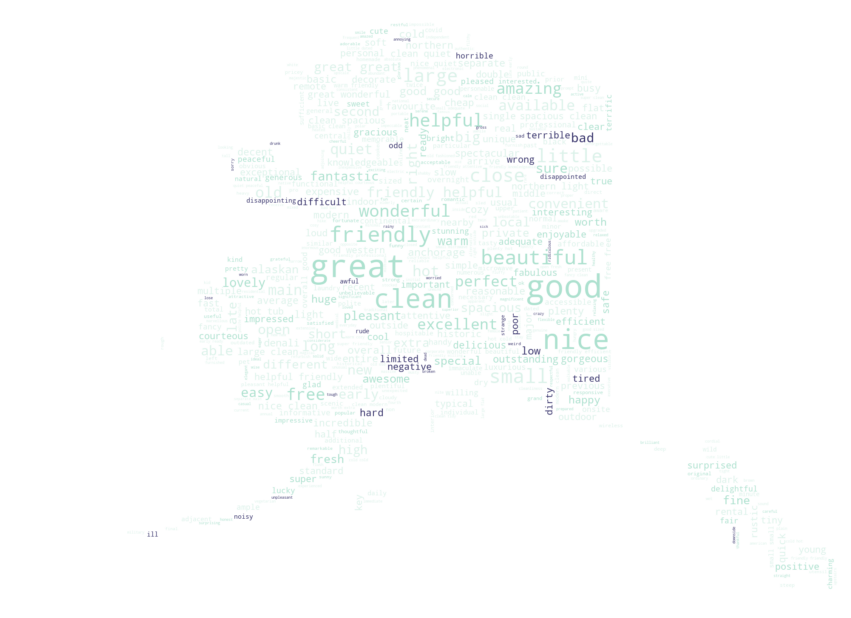

In [247]:
vader_score_dict = get_seasonal_wordcloud(main_df, "Fall", column="Review adjs", pos_color='#ADE1CF', neg_color='#35316A', def_color='#DCF2EA')

In [197]:
seasonal_adj_df

,Month,Season,Corpus
0,1,Winter,key half fond helpful pleasant perfect friendl...
1,2,Winter,peaceful amazing good reserved different open ...
2,3,Spring,overnight plenty positive small friendly norma...
3,4,Spring,major right convenient cold hot small entertai...
4,5,Spring,helpful friendly beautiful clean small helpful...
5,6,Summer,gorgeous clean good friendly amazing pleasant ...
6,7,Summer,nice close major fun little friendly happy pos...
7,8,Summer,extra sneaky great friendly helpful nice good ...
8,9,Fall,nice great terrific clean friendly excellent i...
9,10,Fall,right great fair friendly clean reasonable gre...


In [104]:
winter_adjs = " ".join(list(seasonal_adj_df[seasonal_adj_df["Season"] == "Winter"]["Corpus"]))
spring_adjs = " ".join(list(seasonal_adj_df[seasonal_adj_df["Season"] == "Spring"]["Corpus"]))
summer_adjs = " ".join(list(seasonal_adj_df[seasonal_adj_df["Season"] == "Summer"]["Corpus"]))
fall_adjs = " ".join(list(seasonal_adj_df[seasonal_adj_df["Season"] == "Fall"]["Corpus"]))

In [130]:
from wordcloud import (WordCloud, get_single_color_func)

class GroupedColorFunc(object):
    """Create a color function object which assigns DIFFERENT SHADES of
       specified colors to certain words based on the color to words mapping.

       Uses wordcloud.get_single_color_func

       Parameters
       ----------
       color_to_words : dict(str -> list(str))
         A dictionary that maps a color to the list of words.

       default_color : str
         Color that will be assigned to a word that's not a member
         of any value from color_to_words.
    """

    def __init__(self, color_to_words, default_color):
        self.color_func_to_words = [
            (get_single_color_func(color), set(words))
            for (color, words) in color_to_words.items()]

        self.default_color_func = get_single_color_func(default_color)

    def get_color_func(self, word):
        """Returns a single_color_func associated with the word"""
        try:
            color_func = next(
                color_func for (color_func, words) in self.color_func_to_words
                if word in words)
        except StopIteration:
            color_func = self.default_color_func

        return color_func

    def __call__(self, word, **kwargs):
        return self.get_color_func(word)(word, **kwargs)

class SimpleGroupedColorFunc(object):
    """Create a color function object which assigns EXACT colors
       to certain words based on the color to words mapping

       Parameters
       ----------
       color_to_words : dict(str -> list(str))
         A dictionary that maps a color to the list of words.

       default_color : str
         Color that will be assigned to a word that's not a member
         of any value from color_to_words.
    """

    def __init__(self, color_to_words, default_color):
        self.word_to_color = {word: color
                              for (color, words) in color_to_words.items()
                              for word in words}

        self.default_color = default_color

    def __call__(self, word, **kwargs):
        return self.word_to_color.get(word, self.default_color)

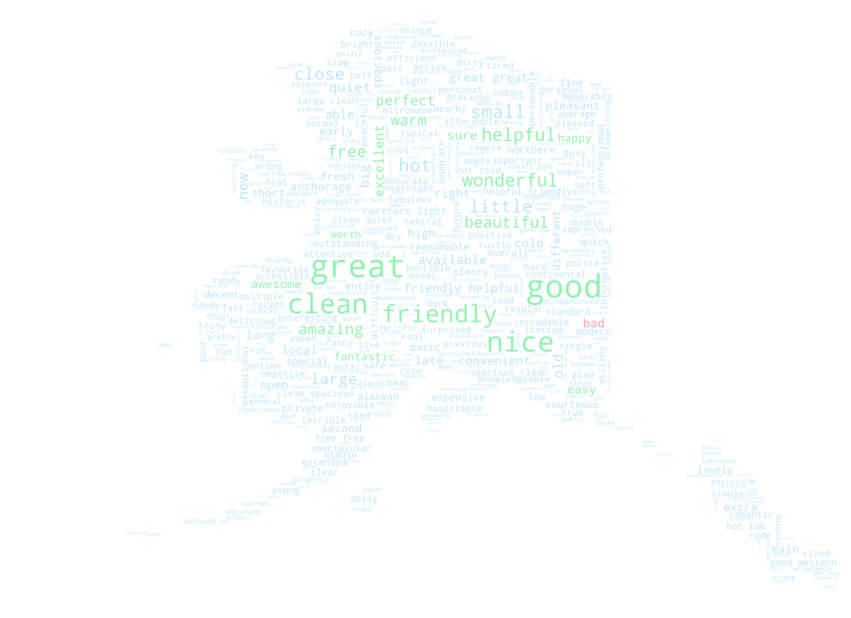

In [140]:
class SimpleGroupedColorFunc(object):
    """Create a color function object which assigns EXACT colors
       to certain words based on the color to words mapping

       Parameters
       ----------
       color_to_words : dict(str -> list(str))
         A dictionary that maps a color to the list of words.

       default_color : str
         Color that will be assigned to a word that's not a member
         of any value from color_to_words.
    """

    def __init__(self, color_to_words, default_color):
        self.word_to_color = {word: color
                              for (color, words) in color_to_words.items()
                              for word in words}

        self.default_color = default_color

    def __call__(self, word, **kwargs):
        return self.word_to_color.get(word, self.default_color)



def get_color_wordcloud(corpus, pos_color='#92F0B2', neg_color='#FD99B2', def_color='#BDE4FD'):

    positive_words = [word for word in list(set(corpus.split(' '))) if word in vader_score_dict and vader_score_dict[word][2] == 1]
    negative_words = [word for word in list(set(corpus.split(' '))) if word in vader_score_dict and vader_score_dict[word][2] == -1]

    text = corpus
    AK_shape = np.array(Image.open('Alaska shape.png'))
    wc = WordCloud(mask=AK_shape, background_color="white",
                max_words=500, max_font_size=75,
                random_state=10, width=AK_shape.shape[1],
                height=AK_shape.shape[0]).generate(text)

    color_to_words = {pos_color: positive_words, neg_color: negative_words}
    default_color = def_color
    grouped_color_func = SimpleGroupedColorFunc(color_to_words, default_color)

    # Apply our color function
    wc.recolor(color_func=grouped_color_func)
    plt.figure(figsize=(15, 15))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show();


get_color_wordcloud(winter_adjs)

In [173]:
corex_df

,Topics,Anchors,Topic words,TC,TCs,Labels,Clusters,Alpha,Mis,P(y)|x,Words,N-gram range,min_df,max_df
0,3,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, restau...",11.934996,"[4.249762626705855, 3.7255220009599173, 3.9597...","[[True, False, True], [True, False, False], [T...","[2, 2, 0, 0, 2, 1, 0, 0, 2, 2, 2, 1, 2, 0, 2, ...","[[1.1650413207217911e-08, 1.5524403891065662e-...","[[0.0, 0.00027572987785486216, 6.1580231655691...","[[0.999999, 1e-06, 0.9999906828432304], [0.999...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
1,4,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, restaurant, l...",13.058124,"[4.338296018684134, 2.775683049541904, 2.97962...","[[True, True, False, False], [False, False, Fa...","[2, 0, 0, 0, 0, 2, 0, 0, 3, 0, 2, 1, 1, 0, 0, ...","[[1.5284500698102388e-24, 1.0, 1.0, 1.0, 1.0, ...","[[0.0, 0.00045690982528585243, 6.6925736463021...","[[0.999999, 0.9999286173517827, 1e-06, 1e-06],...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
2,5,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, restau...",14.800884,"[3.3489755881319967, 2.162141828510189, 3.4417...","[[True, False, True, False, False], [False, Fa...","[3, 0, 0, 0, 0, 4, 0, 0, 1, 2, 2, 2, 2, 0, 2, ...","[[5.0941570152464935e-117, 1.0, 1.0, 1.0, 1.0,...","[[0.0, 0.0003912701548314836, 7.00243313558686...","[[0.999999, 2.8815170178655054e-05, 0.99904490...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
3,6,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, restaurant, airport...",15.342013,"[2.541578628478468, 1.7745312134848927, 3.0349...","[[True, False, True, False, False, False], [Fa...","[4, 0, 2, 5, 0, 4, 5, 5, 3, 4, 2, 4, 4, 5, 2, ...","[[1.5013394800004126e-14, 1.0, 3.8874392753876...","[[0.0, 0.00019608049405618922, 0.0, 2.82877992...","[[0.9998986020331089, 0.01910000383992167, 0.9...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
4,7,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, staff, desk, shuttle, lobby,...",16.172156,"[3.0726748814439078, 1.5667733258083356, 1.279...","[[True, False, False, True, False, True, False...","[3, 0, 0, 0, 6, 4, 0, 6, 2, 6, 6, 6, 4, 0, 6, ...","[[6.77836412640208e-11, 1.0, 1.0, 1.0, 0.00026...","[[0.0, 0.00033387767150354857, 6.1724275491644...","[[0.999999, 0.006164750836851152, 0.0014377450...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
5,8,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, lobby,...",17.223123,"[3.1113677588257476, 2.764391060876677, 1.5398...","[[True, False, True, True, False, False, False...","[1, 0, 4, 0, 0, 1, 0, 0, 5, 1, 7, 6, 4, 0, 7, ...","[[3.035106131298582e-11, 1.0, 1.61650485547122...","[[0.0, 0.0004881579358949392, 6.44960683231423...","[[0.999999, 1e-06, 0.999999, 0.999892039234308...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
6,9,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, restau...",17.139097,"[2.204066681927393, 2.8674782418719658, 1.8860...","[[True, False, True, False, True, False, False...","[5, 4, 5, 4, 4, 1, 5, 5, 3, 5, 5, 5, 1, 0, 5, ...","[[1.2299238131493375e-51, 1.0650772872452096e-...","[[0.0, 0.00019883793045659412, 1.1115813669653...","[[0.999999, 1e-06, 0.999999, 3.202321050247055...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
7,10,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, airpor...",18.372073,"[1.9217943533941213, 1.3784299005285747, 1.607...","[[True, False, False, False, False, False, Fal...","[6, 6, 6, 2, 9, 8, 6, 6, 1, 6, 6, 4, 7, 2, 9, ...","[[3.413920226844167e-24, 1.0833323560445661e-0...","[[0.0, 0.00023104704515137216, 1.2514933847837...","[[0.999999, 0.012771907598427995, 2.9454273597...","[aa, aaa, aaa book, aaa discount, aa

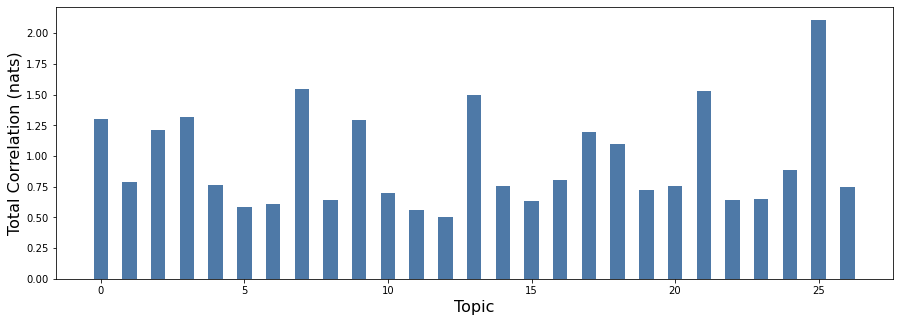

In [42]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,5))
plt.bar(range(corex_df.iloc[24]["TCs"].shape[0]), corex_df.iloc[24]["TCs"], color='#4e79a7', width=0.5)
plt.xlabel('Topic', fontsize=16)
plt.ylabel('Total Correlation (nats)', fontsize=16);

In [141]:
with open("corex_df.pickle", "rb") as to_read:
    corex_df = pickle.load(to_read)

In [178]:
corex_df.iloc[39]["Topic words"]

['Topic #1: beautiful, wonderful, love, perfect, host, bb, home, beautiful view, view, delicious',
 'Topic #2: floor, desk, window, dirty, open, bad, smell, carpet, tell, door',
 'Topic #3: lodge, denali, tour, park, national park, national, food, river, princess, dinner',
 'Topic #4: bed, bathroom, coffee, microwave, kitchen, fridge, tv, bedroom, queen, fruit',
 'Topic #5: cabin, fishing, fish, guide, bear, trip, salmon, owner, experience',
 'Topic #6: shuttle, downtown, walk, airport, distance, restaurant, walk distance, free, shop, location',
 'Topic #7: arrive, day, say, book, review, know, leave, time, make, late']

In [183]:
corex_df.iloc[42]["Topic words"]

['Topic #1: cold, weather, fishing, fish, guide, lodge, salmon, trip, catch, halibut',
 'Topic #2: light, dark, bed, bathroom, floor, window, door, small, open, shower',
 'Topic #3: shuttle, restaurant, airport, walk, downtown, cruise, distance, shop, free, walk distance',
 'Topic #4: cabin, host, beautiful, bb, view, wonderful, owner']

In [167]:
# main_df = main_df.merge(pd.DataFrame(corex_df.iloc[8]["P(y)|x"]), left_index=True, right_index=True)
# main_df = main_df.merge(pd.DataFrame(corex_df.iloc[8]["Labels"]), left_index=True, right_index=True)

In [172]:
main_df

,Property name,Property address,"Lat, long",Reviewer,Review date,Date of stay,Review title,Full review,Review link,Spell-checked review,...,1_y,2_y,3_y,4_y,5_y,6_y,7_y,8_y,9_y,10_y
0,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",John M,October 2020,October 2020,Awesome hotel doing all the right things,I stay at lots of hotels (including during Cov...,https://www.tripadvisor.com/ShowUserReviews-g6...,I stay at lots of hotels including during ovid...,...,True,False,True,True,False,True,False,False,False,False
1,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",Kenai Drift Anglers,October 2020,October 2020,Great Local Get Away,My girlfriend just wanted to get away from tow...,https://www.tripadvisor.com/ShowUserReviews-g6...,My girlfriend just wanted to get away from tow...,...,False,False,False,False,True,False,False,False,False,False
2,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",TravelGirl2006,October 2020,October 2020,We love this hotel,Have stayed here twice on our last two trips t...,https://www.tripadvisor.com/ShowUserReviews-g6...,Have stayed here twice on our last two trips t...,...,False,False,False,False,False,False,False,False,True,False
3,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",maduro44,October 2020,September 2020,Bed,Everything was really nice almost great if it ...,https://www.tripadvisor.com/ShowUserReviews-g6...,Everything was really nice almost great if it ...,...,False,False,False,False,False,False,False,False,False,False
4,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",rtfields2020,October 2020,September 2020,Great place,"Terrific place to stay. Comfortable and clean,...",https://www.tripadvisor.com/ShowUserReviews-g6...,Terrific place to stay. Comfortable and clean ...,...,False,False,False,False,False,False,False,False,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94508,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",HoneyLea,September 2016,August 2016,"Poor site placement, busy highway nearby",I was really disappointed with the site were w...,https://www.tripadvisor.com/ShowUserReviews-g6...,I was really disappointed with the site were w...,...,False,False,False,True,False,False,True,False,False,False
94509,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",wknIV,September 2016,September 2016,Accomodating staff!,I knew we would be checking in very late to th...,https://www.tripadvisor.com/ShowUserReviews-g6...,I knew we would be checking in very late to th...,...,False,False,False,True,False,False,True,True,False,False
94510,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",Brian8074,September 2016,September 2016,Quick trip from Anchorage,Pretty nice little place. We have a 38ft 5th w...,https://www.tripadvisor.com/ShowUserReviews-g6...,Pretty nice little place We have a 38ft 5th wh...,...,False,False,False,False,False,False,True,True,False,False
94511,River's Edge RV Park & Campground,"4200 Boat St, Fairbanks, AK 99709-4696","64.840858,-147.839966",Mary V,September 2016,August 2016,Right on the Chena River - beautiful campground!,There are many reasons I would rate this campg...,https://www.tripadvisor.com/ShowUserReviews-g6...,There are many reasons I would rate this campg...,...,False,False,False,False,False,False,True,False,False,False


In [148]:
corex_df.iloc[8]["Topic words"]

['Topic #1: hotel, shuttle, desk, airport, staff, lobby, stay hotel, service',
 'Topic #2: kitchen, bedroom, bathroom, living, living room, private, share, bath, light, separate',
 'Topic #3: host, home, bb, make, feel, wonderful, make feel, delicious, house, family',
 'Topic #4: downtown, walk, distance, walk distance, location, locate, restaurant, easy, free, town',
 'Topic #5: floor, noise, window, wall, open, shower, door, carpet, fan, sleep',
 'Topic #6: food, dinner, eat, meal, lunch, food good, good food, menu, drink, great food',
 'Topic #7: coffee, microwave, bed, breakfast, fridge, queen, fruit, egg, tv, cereal',
 'Topic #8: check, tell, arrive, say, review, ask, book, leave, reservation, bad',
 'Topic #9: park, denali, national park, national, tour, princess, bus, train, rv, shop',
 'Topic #10: view, mountain, great view, deck, beautiful, overlook, view room, beautiful view, bay, view mountain',
 'Topic #11: fishing, fish, guide, salmon, trip, bear, catch, boat, halibut, exp

In [49]:
corex_df.iloc[9]["Topic words"]

['Topic #1: hotel, shuttle, cruise, airport, desk, restaurant, lobby, stay hotel, hotel room, shuttle service',
 'Topic #2: kitchen, bed, coffee, bedroom, bathroom, queen, living, living room, large, tea',
 'Topic #3: enjoy, wonderful, beautiful, love, delicious, perfect, cozy, enjoy stay, decorate, lovely',
 'Topic #4: floor, noise, window, smell, dirty, carpet, wall, door, bad, open',
 'Topic #5: downtown, walk, distance, breakfast, walk distance, locate, location, continental, free, continental breakfast',
 'Topic #6: fishing, fish, guide, trip, salmon, catch, experience, halibut, boat, bear',
 'Topic #7: host, bb, home, house, feel, make, make feel, owner, feel home',
 'Topic #8: park, denali, shower, national park, microwave, national, rv, fridge, tv, denali national',
 'Topic #9: view, mountain, glacier, great view, bay, deck, overlook, view room, beautiful view, spectacular',
 'Topic #10: arrive, check, tell, late, early, reservation, leave, ask, pm, book',
 'Topic #11: cabin, l

In [146]:
corex_df.iloc[32]["Topic words"]

['Topic #1: hotel, floor, lobby, desk, princess, cruise, old, carpet, elevator, smell',
 'Topic #2: dinner, meal, deck, food, lunch, sit, eat, dining, enjoy, northern',
 'Topic #3: fishing, fish, guide, salmon, trip, bear, boat, catch, halibut, experience',
 'Topic #4: breakfast, continental, buffet, breakfast good, fruit, continental breakfast, egg, bed breakfast, morning, breakfast morning',
 'Topic #5: shuttle, downtown, airport, walk, distance, walk distance, restaurant, shuttle service, locate, free',
 'Topic #6: cabin, host, bb, owner, house, wonderful, private, cozy',
 'Topic #7: denali, view, park, mountain, national park, national, beautiful, river, denali national, overlook',
 'Topic #8: arrive, check, late, early, tell, book, reservation, leave, pm, review',
 'Topic #9: shower, noise, window, door, open, toilet, water, hear, wall, hot water',
 'Topic #10: feel, kitchen, make, home, feel like, make sure, make feel, bedroom, living, like',
 'Topic #11: say, pay, ask, try, mone

In [142]:
corex_df

,Topics,Anchors,Topic words,TC,TCs,Labels,Clusters,Alpha,Mis,P(y)|x,Words,N-gram range,min_df,max_df
0,3,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, restau...",11.934996,"[4.249762626705855, 3.7255220009599173, 3.9597...","[[True, False, True], [True, False, False], [T...","[2, 2, 0, 0, 2, 1, 0, 0, 2, 2, 2, 1, 2, 0, 2, ...","[[1.1650413207217911e-08, 1.5524403891065662e-...","[[0.0, 0.00027572987785486216, 6.1580231655691...","[[0.999999, 1e-06, 0.9999906828432304], [0.999...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
1,4,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, restaurant, l...",13.058124,"[4.338296018684134, 2.775683049541904, 2.97962...","[[True, True, False, False], [False, False, Fa...","[2, 0, 0, 0, 0, 2, 0, 0, 3, 0, 2, 1, 1, 0, 0, ...","[[1.5284500698102388e-24, 1.0, 1.0, 1.0, 1.0, ...","[[0.0, 0.00045690982528585243, 6.6925736463021...","[[0.999999, 0.9999286173517827, 1e-06, 1e-06],...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
2,5,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, restau...",14.800884,"[3.3489755881319967, 2.162141828510189, 3.4417...","[[True, False, True, False, False], [False, Fa...","[3, 0, 0, 0, 0, 4, 0, 0, 1, 2, 2, 2, 2, 0, 2, ...","[[5.0941570152464935e-117, 1.0, 1.0, 1.0, 1.0,...","[[0.0, 0.0003912701548314836, 7.00243313558686...","[[0.999999, 2.8815170178655054e-05, 0.99904490...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
3,6,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, restaurant, airport...",15.342013,"[2.541578628478468, 1.7745312134848927, 3.0349...","[[True, False, True, False, False, False], [Fa...","[4, 0, 2, 5, 0, 4, 5, 5, 3, 4, 2, 4, 4, 5, 2, ...","[[1.5013394800004126e-14, 1.0, 3.8874392753876...","[[0.0, 0.00019608049405618922, 0.0, 2.82877992...","[[0.9998986020331089, 0.01910000383992167, 0.9...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
4,7,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, staff, desk, shuttle, lobby,...",16.172156,"[3.0726748814439078, 1.5667733258083356, 1.279...","[[True, False, False, True, False, True, False...","[3, 0, 0, 0, 6, 4, 0, 6, 2, 6, 6, 6, 4, 0, 6, ...","[[6.77836412640208e-11, 1.0, 1.0, 1.0, 0.00026...","[[0.0, 0.00033387767150354857, 6.1724275491644...","[[0.999999, 0.006164750836851152, 0.0014377450...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
5,8,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, lobby,...",17.223123,"[3.1113677588257476, 2.764391060876677, 1.5398...","[[True, False, True, True, False, False, False...","[1, 0, 4, 0, 0, 1, 0, 0, 5, 1, 7, 6, 4, 0, 7, ...","[[3.035106131298582e-11, 1.0, 1.61650485547122...","[[0.0, 0.0004881579358949392, 6.44960683231423...","[[0.999999, 1e-06, 0.999999, 0.999892039234308...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
6,9,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, restau...",17.139097,"[2.204066681927393, 2.8674782418719658, 1.8860...","[[True, False, True, False, True, False, False...","[5, 4, 5, 4, 4, 1, 5, 5, 3, 5, 5, 5, 1, 0, 5, ...","[[1.2299238131493375e-51, 1.0650772872452096e-...","[[0.0, 0.00019883793045659412, 1.1115813669653...","[[0.999999, 1e-06, 0.999999, 3.202321050247055...","[aa, aaa, aaa book, aaa discount, aaa rate, aa...","(1, 2)",5,0.5
7,10,"[[hotel, lodge], [aurora, northern lights]]","[Topic #1: hotel, shuttle, desk, staff, airpor...",18.372073,"[1.9217943533941213, 1.3784299005285747, 1.607...","[[True, False, False, False, False, False, Fal...","[6, 6, 6, 2, 9, 8, 6, 6, 1, 6, 6, 4, 7, 2, 9, ...","[[3.413920226844167e-24, 1.0833323560445661e-0...","[[0.0, 0.00023104704515137216, 1.2514933847837...","[[0.999999, 0.012771907598427995, 2.9454273597...","[aa, aaa, aaa book, aaa discount, aa

In [38]:
corex_df.iloc[21]["Labels"]

array([[ True, False, False, ..., False, False, False],
       [ True, False,  True, ..., False,  True, False],
       [ True, False, False, ..., False, False,  True],
       ...,
       [ True, False,  True, ...,  True, False, False],
       [ True, False, False, ..., False, False, False],
       [ True, False, False, ..., False, False, False]])

In [55]:
import pandas as pd
for_plotting = pd.DataFrame(corex_df.iloc[24]["TCs"])
for_plotting.to_csv("TCs plot.csv")

In [58]:
type(for_plotting.iloc[0, 0])

numpy.float64